## Disorder and secondary structure of alanine scanning mutants of phytoene desaturase

Each residue of the amino acid sequence of phytoene desaturase (PDB ID: 4dgk) was mutated independently. Iupred disorder predictions and Psipred secondary structure predictions of all mutants were generated. The change in disorder and in secondary structure is plotted below for all mutants.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os

In [2]:
def read_iupred_dict(file):
    """
    Read disorder predictions produced by IUPRED2 from the .dis file
    Inputs:
        - file: Filename of the .result file outputted by IUPRED2
    Returns:
        - iupred_dict: Dictionary of prot keys and dis values
        where
        - prot: Protein sequence (string)
        - dis:  List of predicted disorder (values between 0 and 1)
    """
    
    f = open(file, 'r')
    iupred_dict = dict()
    dis = []
    prot = ''
    
    for line in f:
        line = line.strip()
        if line.startswith('>'):
            iupred_dict[prot] = dis
            dis = []
            prot = ''
            continue
        if '#' in line or line == "":
            continue
        tokens = line.split()
        assert len(tokens) == 4, tokens
        
        prot += tokens[1]
        dis.append(float(tokens[2]))
        
    iupred_dict[prot] = dis
    iupred_dict.pop("")
        
    f.close()
    return iupred_dict

In [3]:
def get_psipred_ss2(file):
    """
    Read secondary structure predictions produced by PSIPRED
    Input:
        - file: Filename of the .ss2 file output by PSIPRED
    Returns:
        - prot: Protein sequence (string)
        - ss2_dict: Dictionary with keys H, C, E, and their corresponding arrays of predictions as the values
    """
    
    f = open(file, 'r')
    prot = ''
    ss2_dict = {'H':[], 'C':[], 'E':[]}
    
    for line in f:
        line = line.strip()
        if '#' in line or line == "":
            continue
        tokens = line.split()
        assert len(tokens) == 6
        
        prot += tokens[1]
        ss2_dict['C'].append(float(tokens[3]))
        ss2_dict['H'].append(float(tokens[4]))
        ss2_dict['E'].append(float(tokens[5]))
        
    return prot, ss2_dict

In [4]:
iupred_ref = read_iupred_dict('4dgk.result')

prot_ref, ss2_dict = get_psipred_ss2('4dgk.ss2')
psipred_ref = {prot_ref:ss2_dict}

In [5]:
iupred = read_iupred_dict('4dgk_ms_all.result')  # key is amino acid sequence, value is list of disorder preds

In [6]:
psipred = dict()  # key is amino acid sequence, value is dict of ss preds
seqs = dict()  # key is pos mutated to A, value is mutated sequence

for i in range(501):
    filename = '4dgk_' + str(i+1) + '.ss2'
    if os.path.exists(filename):
        prot, ss2_dict = get_psipred_ss2(filename)
        psipred[prot] = ss2_dict
        seqs[i+1] = prot

Change in disorder and secondary structure will be represented in 2 ways: traces and heat maps

Traces are easy to interpret. 
- x-axis: residue position
- y-axis: new disorder/ss value - old disorder/ss value

Heat maps sacrifice a bit of readability to compress the information in the traces. They also make it easier to observe correlations between alanine mutants.
- x-axis: reference amino acid sequence
- y-axis: (new disorder/ss value - old disorder/ss value) across the sequence, per mutant
- color gradient: increasingly red for increasingly positive value changes, increasingly blue for increasingly negative value changes

In [7]:
import matplotlib.backends.backend_pdf
import seaborn as sns

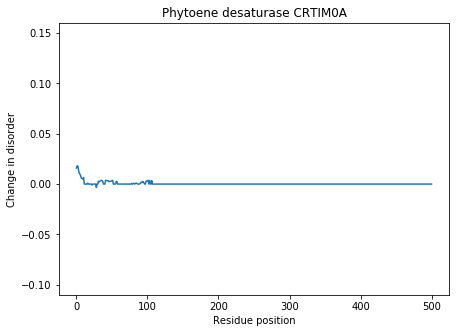

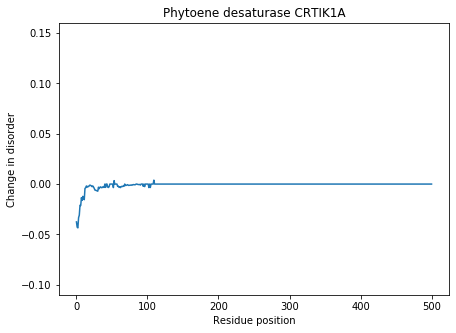

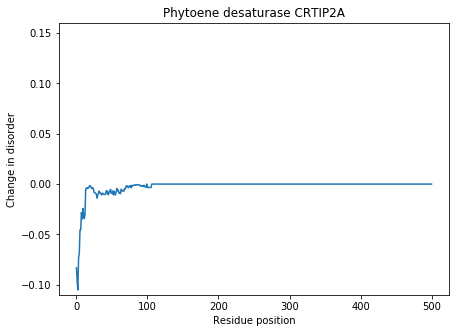

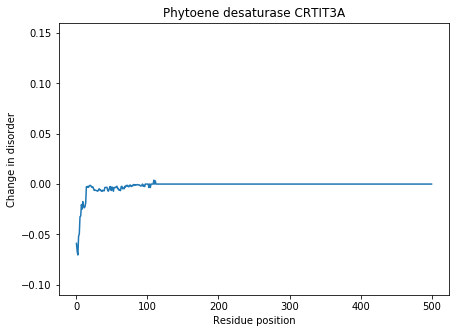

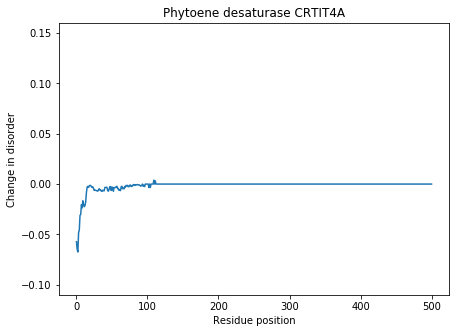

...

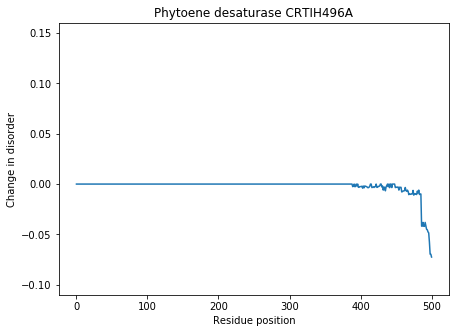

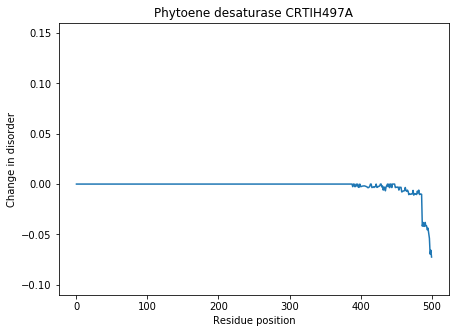

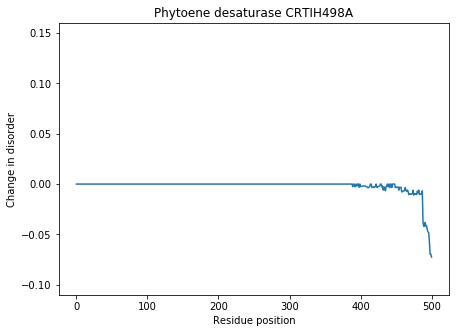

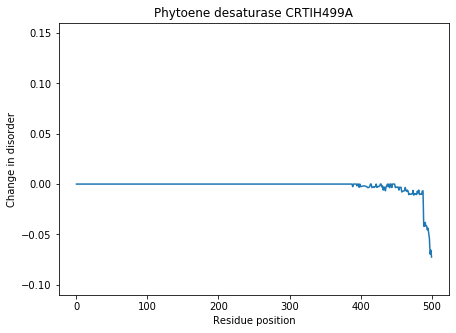

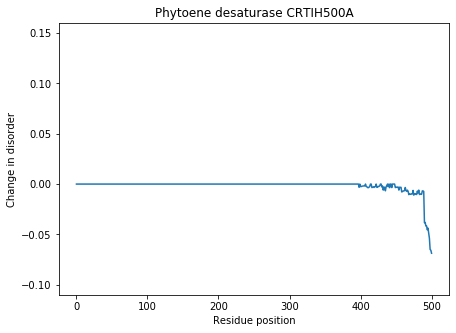

In [8]:
# Disorder traces

iupred_delta = dict()  # key is pos mutated to A, value is disorder of mutant - disorder of ref
iupred_ref_preds = np.array(iupred_ref[prot_ref])

pdf = matplotlib.backends.backend_pdf.PdfPages("disorder_traces.pdf")

for pos, seq in seqs.items():
    iupred_delta[pos] = np.array(iupred[seq]) - iupred_ref_preds
    plt.figure(figsize=(7,5))
    plt.plot(iupred_delta[pos])
    plt.title('Phytoene desaturase CRTI' + prot_ref[pos-1] + str(pos-1) + 'A')
    plt.xlabel('Residue position')
    plt.ylabel('Change in disorder')
    plt.ylim(-0.11, 0.16)   # (max, min) = (0.15589999999999993, -0.1052)
    pdf.savefig()
    plt.show()
    
pdf.close()

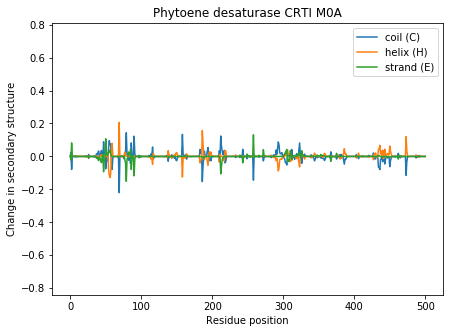

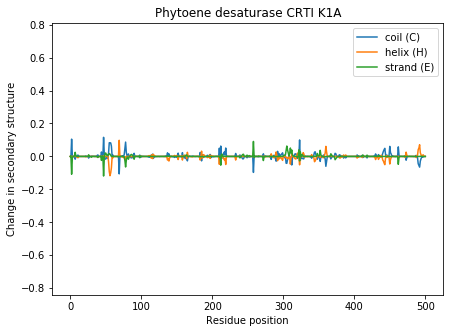

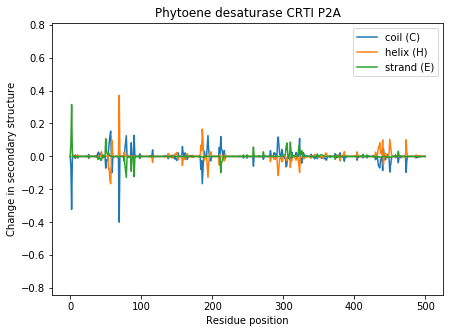

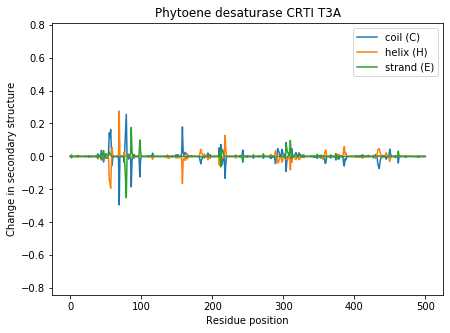

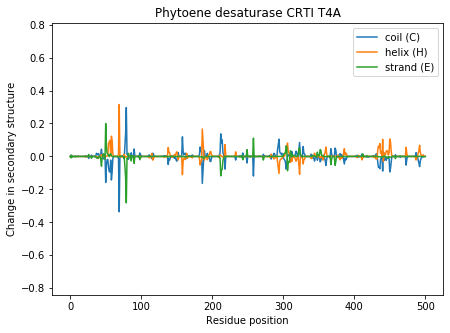

...

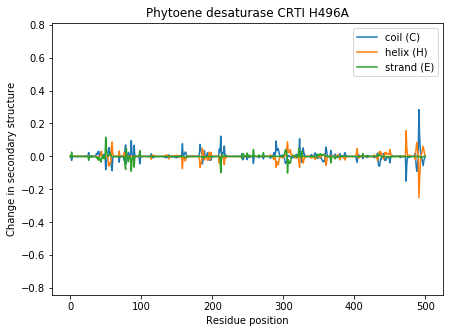

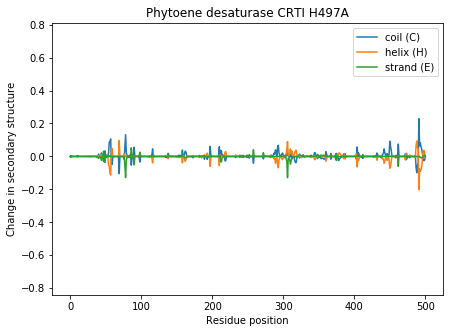

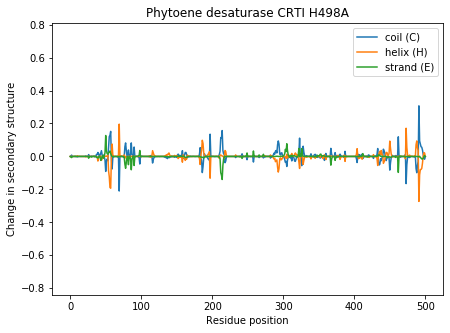

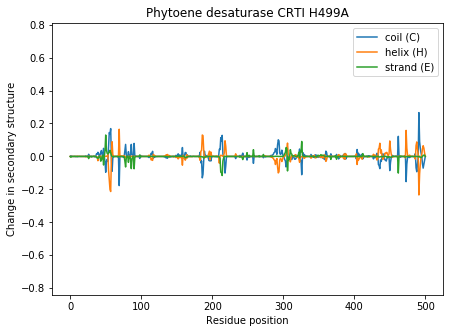

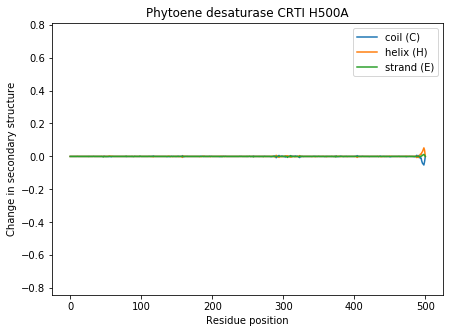

In [9]:
# Secondary structure traces

psipred_delta_C = dict()  # key is pos mutated to A, value is ss of mutant - ss of ref (C only)
psipred_delta_H = dict()  # key is pos mutated to A, value is ss of mutant - ss of ref (H only)
psipred_delta_E = dict()  # key is pos mutated to A, value is ss of mutant - ss of ref (E only)
psipred_ref_C = np.array(psipred_ref[prot_ref]['C'])
psipred_ref_H = np.array(psipred_ref[prot_ref]['H'])
psipred_ref_E = np.array(psipred_ref[prot_ref]['E'])

pdf = matplotlib.backends.backend_pdf.PdfPages("secondary_structure_traces.pdf")

for pos, seq in seqs.items():
    psipred_delta_C[pos] = np.array(psipred[seq]['C']) - psipred_ref_C
    psipred_delta_H[pos] = np.array(psipred[seq]['H']) - psipred_ref_H
    psipred_delta_E[pos] = np.array(psipred[seq]['E']) - psipred_ref_E
    plt.figure(figsize=(7,5))
    plt.plot(psipred_delta_C[pos], label='coil (C)')
    plt.plot(psipred_delta_H[pos], label='helix (H)')
    plt.plot(psipred_delta_E[pos], label='strand (E)')
    plt.title('Phytoene desaturase CRTI ' + prot_ref[pos-1] + str(pos-1) + 'A')
    plt.xlabel('Residue position')
    plt.ylabel('Change in secondary structure')
    plt.ylim(-0.84, 0.81)   # (max, min) = (0.8079999999999999, -0.832)
    plt.legend()
    pdf.savefig()
    plt.show()
    
pdf.close()

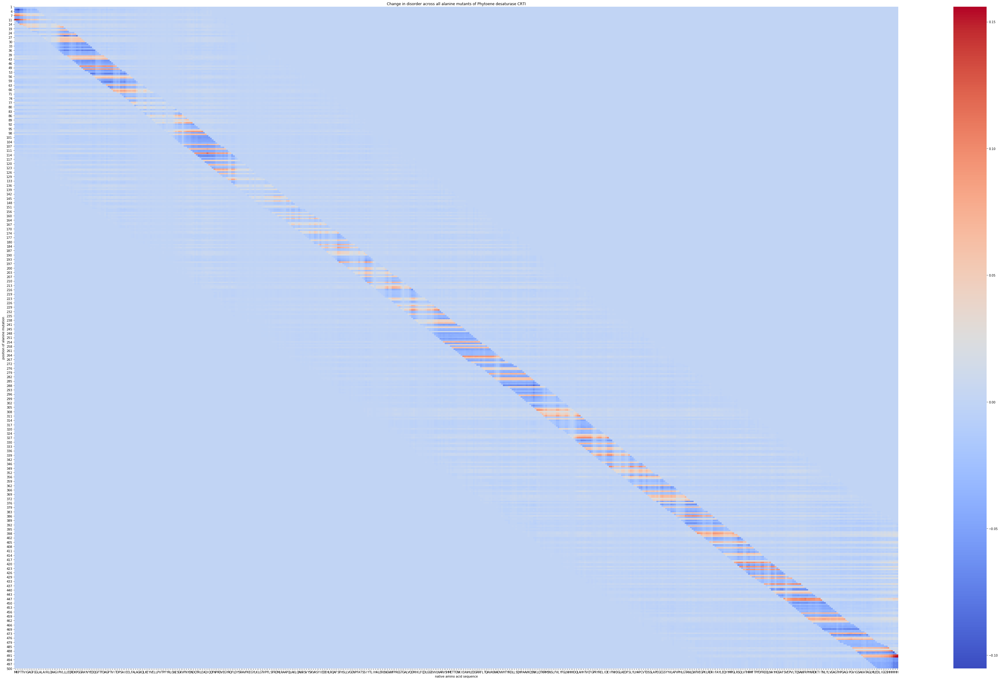

In [10]:
# Disorder heat map
df = pd.DataFrame(data=iupred_delta)
df_disorder = df.T.rename(columns=dict( zip(list(range(501)), list(prot_ref)) ))

plt.figure(figsize=(65,40))
sns.heatmap(df_disorder, cmap='coolwarm', xticklabels=1)
plt.xticks(rotation=0)
plt.title('Change in disorder across all alanine mutants of Phytoene desaturase CRTI')
plt.ylabel('position of alanine mutation')
plt.xlabel('native amino acid sequence')
plt.savefig('disorder_heat_map', dpi=300)

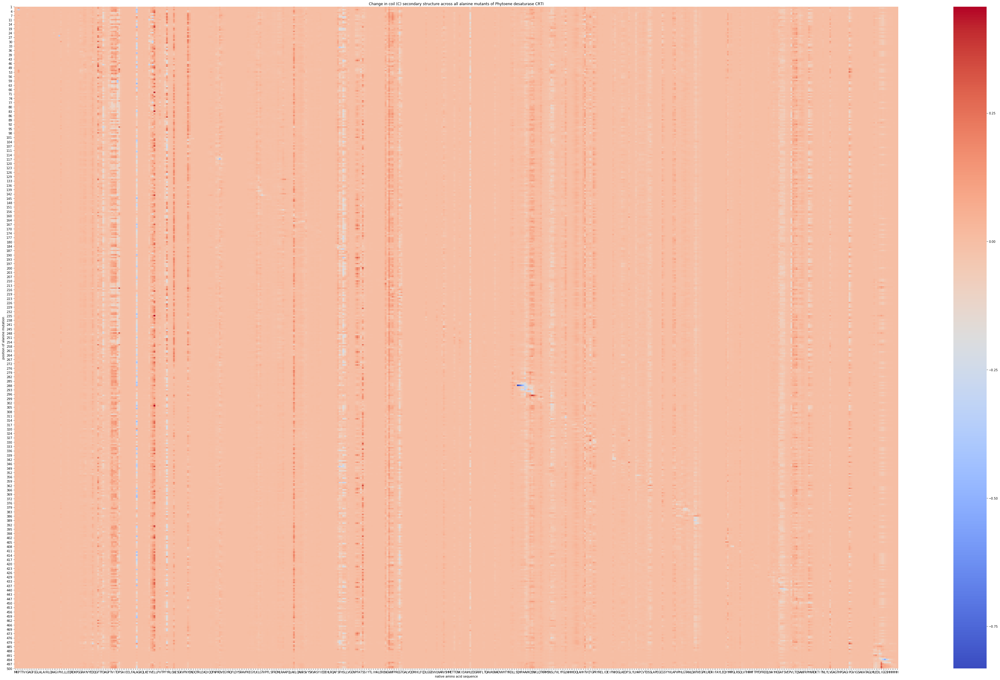

In [11]:
# Secondary structure heat maps
df = pd.DataFrame(data=psipred_delta_C)
df_ssC = df.T.rename(columns=dict( zip(list(range(501)), list(prot_ref)) ))

plt.figure(figsize=(65,40))
sns.heatmap(df_ssC, cmap='coolwarm', xticklabels=1)
plt.xticks(rotation=0)
plt.title('Change in coil (C) secondary structure across all alanine mutants of Phytoene desaturase CRTI')
plt.ylabel('position of alanine mutation')
plt.xlabel('native amino acid sequence')
plt.savefig('ssC_heat_map', dpi=300)

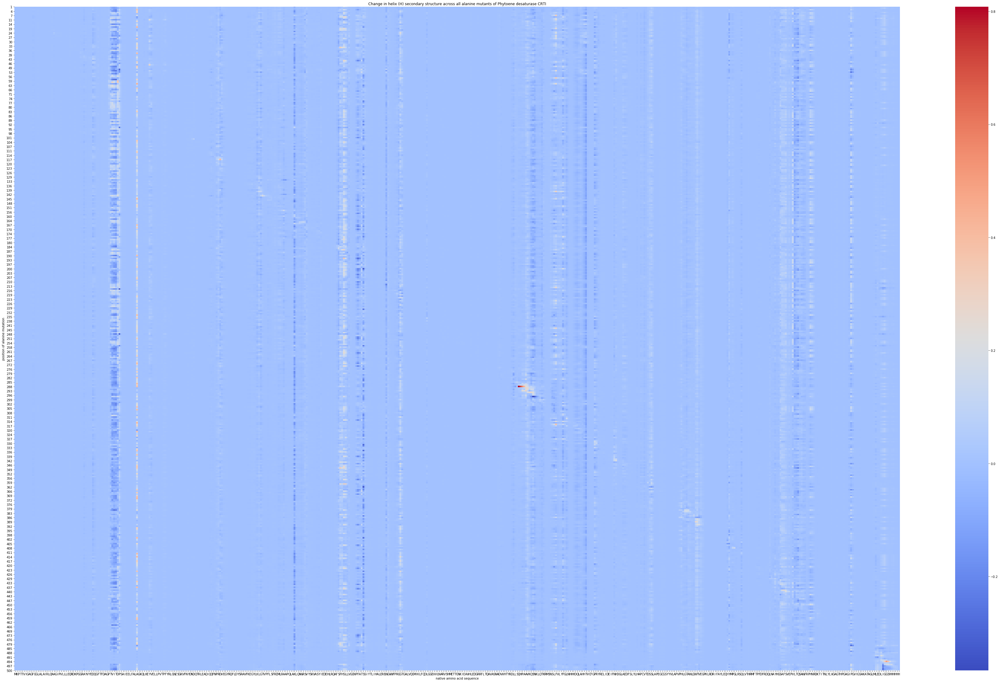

In [12]:
df = pd.DataFrame(data=psipred_delta_H)
df_ssH = df.T.rename(columns=dict( zip(list(range(501)), list(prot_ref)) ))

plt.figure(figsize=(65,40))
sns.heatmap(df_ssH, cmap='coolwarm', xticklabels=1)
plt.xticks(rotation=0)
plt.title('Change in helix (H) secondary structure across all alanine mutants of Phytoene desaturase CRTI')
plt.ylabel('position of alanine mutation')
plt.xlabel('native amino acid sequence')
plt.savefig('ssH_heat_map', dpi=300)

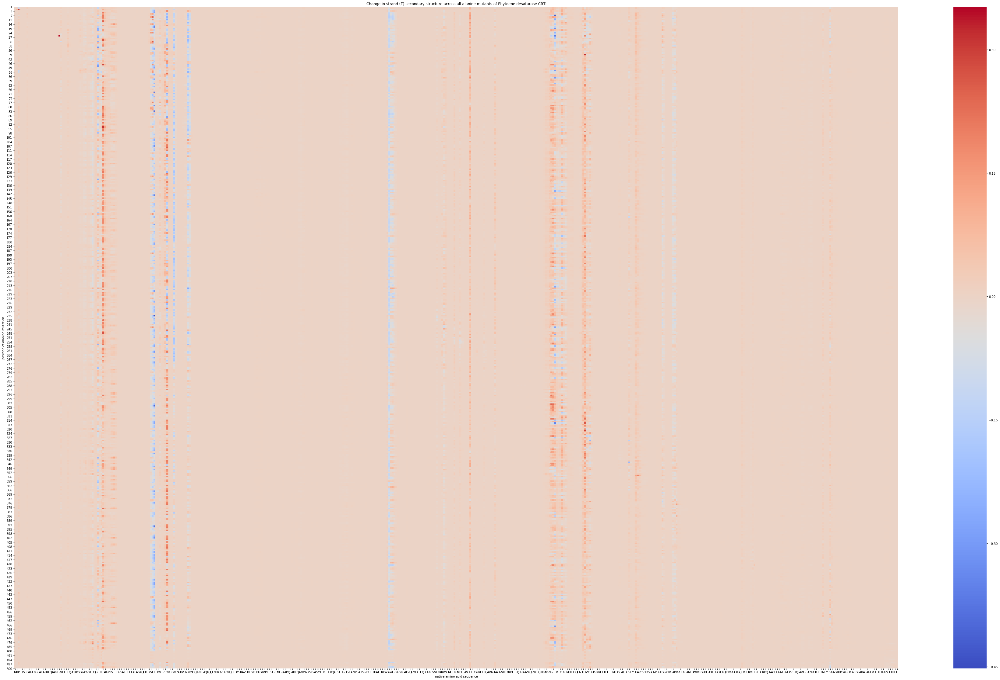

In [13]:
df = pd.DataFrame(data=psipred_delta_E)
df_ssE = df.T.rename(columns=dict( zip(list(range(501)), list(prot_ref)) ))

plt.figure(figsize=(65,40))
sns.heatmap(df_ssE, cmap='coolwarm', xticklabels=1)
plt.xticks(rotation=0)
plt.title('Change in strand (E) secondary structure across all alanine mutants of Phytoene desaturase CRTI')
plt.ylabel('position of alanine mutation')
plt.xlabel('native amino acid sequence')
plt.savefig('ssE_heat_map', dpi=300)

### Disorder

Both the traces and heatmap show that the effect of the alanine mutants on disorder is very localized. Disorder prediction values increase/decrease slightly in a region of ~20 residues centered on the position of the mutant. Some of these 20-residue regions show particularly small changes in disorder. They correspond to areas of the protein that were already disordered (i.e., protein loops), so the alanine mutants had very little effect.


### Secondary structure

Unlike what is observed for disorder, the traces and heatmaps of the alanine mutants show that changes in secondary structure are not localized. Across all alanine mutant positions, a few regions in the protein are particularly prone to secondary structure changes. Many of these regions are the substrate-binding regions identified by Schaub, et. al (2012) (see PDB ID: 4DGK). Many of the alanine mutants appear to "break" helical regions (decreased H character and increased C character), but this is misleading since most of the substrate-binding regions are beta-strands. Oddly, the heatmaps show that some beta-strand regions have higher E character in the alanine mutants. A possible future experiment would investigate whether these regions correspond to highly-conserved domains of the protein.